## Tacotron 2 inference code 
Edit the variables **checkpoint_path** and **text** to match yours and run the entire code to generate plots of mel outputs, alignments and audio synthesis from the generated mel-spectrogram using Griffin-Lim.

#### Import libraries and setup matplotlib

In [1]:
import matplotlib
%matplotlib inline
import matplotlib.pylab as plt
import os
import IPython.display as ipd

import sys
sys.path.append('waveglow/')
import numpy as np
import torch
import librosa

from hparams import create_hparams
from model import Tacotron2
from layers import TacotronSTFT, STFT
from audio_processing import griffin_lim
from train import load_model
from text import text_to_sequence
from denoiser import Denoiser

/home/cookie/.local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/cookie/.local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/cookie/.local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/cookie/.local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:529: 

#### Convert to Phonemes

In [2]:
dictionary_path = r"/media/cookie/Samsung PM961/TwiBot/tacotron2/filelists/merged.dict_.txt"
print("Running, Please wait...")
thisdict = {}
for line in ((open(dictionary_path, "r").read()).splitlines()):
    thisdict[(line.split(" ", 1))[0]] = (line.split(" ", 1))[1].strip()
print("Dictionary Ready.")
sym = list("☺☻♥♦♣♠•◘○◙♂♀♪♫☼►◄↕‼¶§▬↨↑↓→←∟↔▲▼")
def ARPA(phrase):
    errored_words = ""
    phoneme_embed = ""
    for i in sym:
        if i in phrase:
            phoneme_embed = phoneme_embed + i
            phrase = phrase.replace(i, "")
    for word in phrase.split(" "):
        try:
          try:
            if len(word) > 2:
              if word[-3:] == "?!;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-3])] + "}?!;"
              elif word[-3:] == "!?;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-3])] + "}!?;"
              elif word[-2:] == "!?":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!? "
              elif word[-2:] == "?!":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?! "
              elif word[-2:] == ".;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}.;"
              elif word[-2:] == ",;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "},;"
              elif word[-2:] == "?;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?;"
              elif word[-2:] == "!;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!;"
              elif word[-1] == ".":
                phoneme_embed +=  "{" + thisdict[(word.upper()[0:-1])] + "}. "
              elif word[-1] == ",":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}, "
              elif word[-1] == "?":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}? "
              elif word[-1] == "!":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}! "
              elif word[-1] == ";":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "};"
              else:
                phoneme_embed += "{" + thisdict[word.upper()] + "} "
            elif len(word) > 1:
              if word[-2:] == "!?":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!? "
              elif word[-2:] == "?!":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?! "
              elif word[-2:] == ".;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}.;"
              elif word[-2:] == ",;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "},;"
              elif word[-2:] == "?;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?;"
              elif word[-2:] == "!;":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!;"
              elif word[-1] == ".":
                phoneme_embed +=  "{" + thisdict[(word.upper()[0:-1])] + "}. "
              elif word[-1] == ",":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}, "
              elif word[-1] == "?":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}? "
              elif word[-1] == "!":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}! "
              elif word[-1] == ";":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "};"
              else:
                phoneme_embed += "{" + thisdict[word.upper()] + "} "
            else:
              if word[-1] == ".":
                phoneme_embed +=  "{" + thisdict[(word.upper()[0:-1])] + "}. "
              elif word[-1] == ",":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}, "
              elif word[-1] == "?":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}? "
              elif word[-1] == "!":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}! "
              elif word[-1] == ";":
                phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "};"
              else:
                phoneme_embed += "{" + thisdict[word.upper()] + "} "
          except KeyError:
            word_split = word.upper().replace("'S"," :::").replace("'"," '").replace("-"," ").replace("A.M","A M").replace("P.M","P M").replace("P.O","P O").replace("U.S","U S").replace(" :::"," 'S").replace("E.G","E G").split(" ")
            for word in word_split:
              if len(word) > 2:
                if word[-3:] == "?!;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-3])] + "}?!;"
                elif word[-3:] == "!?;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-3])] + "}!?;"
                elif word[-2:] == "!?":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!? "
                elif word[-2:] == "?!":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?! "
                elif word[-2:] == ".;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}.;"
                elif word[-2:] == ",;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "},;"
                elif word[-2:] == "?;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?;"
                elif word[-2:] == "!;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!;"
                elif word[-1] == ".":
                  phoneme_embed +=  "{" + thisdict[(word.upper()[0:-1])] + "}. "
                elif word[-1] == ",":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}, "
                elif word[-1] == "?":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}? "
                elif word[-1] == "!":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}! "
                elif word[-1] == ";":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "};"
                else:
                  phoneme_embed += "{" + thisdict[word.upper()] + "} "
              elif len(word) > 1:
                if word[-2:] == "!?":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!? "
                elif word[-2:] == "?!":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?! "
                elif word[-2:] == ".;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}.;"
                elif word[-2:] == ",;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "},;"
                elif word[-2:] == "?;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}?;"
                elif word[-2:] == "!;":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-2])] + "}!;"
                elif word[-1] == ".":
                  phoneme_embed +=  "{" + thisdict[(word.upper()[0:-1])] + "}. "
                elif word[-1] == ",":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}, "
                elif word[-1] == "?":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}? "
                elif word[-1] == "!":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}! "
                elif word[-1] == ";":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "};"
                else:
                  phoneme_embed += "{" + thisdict[word.upper()] + "} "
              elif len(word) > 0:
                if word[-1] == ".":
                  phoneme_embed +=  "{" + thisdict[(word.upper()[0:-1])] + "}. "
                elif word[-1] == ",":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}, "
                elif word[-1] == "?":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}? "
                elif word[-1] == "!":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "}! "
                elif word[-1] == ";":
                  phoneme_embed += "{" + thisdict[(word.upper()[0:-1])] + "};"
                else:
                  phoneme_embed += "{" + thisdict[word.upper()] + "} "
        except KeyError as e:
          errored_words = errored_words + str(e)[1:-1] + "\n"
          print(str(e))
    return phoneme_embed


Running, Please wait...
Dictionary Ready.


In [3]:
!pip3 show torch

Name: torch
Version: 1.1.0
Summary: Tensors and Dynamic neural networks in Python with strong GPU acceleration
Home-page: UNKNOWN
Author: UNKNOWN
Author-email: UNKNOWN
License: UNKNOWN
Location: /home/cookie/.local/lib/python3.7/site-packages
Requires: numpy
Required-by: torchvision


In [3]:
def plot_data(data, figsize=(16, 4)):
    fig, axes = plt.subplots(1, len(data), figsize=figsize)
    for i in range(len(data)):
        axes[i].imshow(data[i], aspect='auto', origin='bottom', 
                       interpolation='none')

#### Setup hparams

In [4]:
hparams = create_hparams()
print(hparams.sampling_rate)


For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
If you depend on functionality not listed there, please file an issue.

48000


#### Load model from checkpoint

In [6]:
checkpoint_path = "outdir_twilight/checkpoint_15000"
checkpoint_path = "outdir_twilight3/checkpoint_18284"
checkpoint_path = "outdir_twilight3/checkpoint_32000"
checkpoint_path = "outdir_twilight5/checkpoint_7000"
#checkpoint_path = "outdir_LJ1/checkpoint_21429"

model = load_model(hparams)
model.load_state_dict(torch.load(checkpoint_path)['state_dict'])
_ = model.cuda().eval().half()

#### Load WaveGlow for mel2audio synthesis and denoiser

In [7]:
#waveglow_path = 'waveglow_latest/checkpoints/waveglow_42000'
#waveglow_path = '../mellotron/models/waveglow_256channels_v4.pt'
waveglow_path = 'waveglow_latest/outdir_twilight/waveglow_6000' # SR 22050, Max Freq 8000
waveglow_path = 'waveglow_latest/outdir_twilight2/waveglow_4257' # SR 22050, Max Freq 11025
waveglow_path = 'waveglow_latest/outdir_twilight3/waveglow_7399' # SR 48000, Max Freq 24000
waveglow = torch.load(waveglow_path)['model']
waveglow.cuda().eval().half()
for k in waveglow.convinv:
    k.float()
denoiser = Denoiser(waveglow)
# Pretrained model fails on anything > Pytorch 1.0

#### Synthesis

In [8]:
ARPA("""What's a faggot?;""")

'{HH W AH1 T S} {EY1} {F AE1 G AH0 T}?;'

Sigma=0.9
{AY1} {HH AE1 V} {DH IY0} {B IH0 L IY1 F} {DH AH0 T} {DH IH0 S} {M AA1 D AH0 L} {IH1 Z} {G OW1 IH0 NG} {T UW1} {HH AE1 V} {T R AH1 B AH0 L} {S P IY1 K IH0 NG} {L AO1 NG} {S EH1 N T AH0 N S AH0 Z}, {AH0 S P EH1 SH L IY0} {HH W IH1 N} {DH EY1} {K AH0 N T EY1 N} {K AA1 M AH0 Z}.;
Warning! Reached max decoder steps

No Denoise


0.5% Denoise


1% Denoise


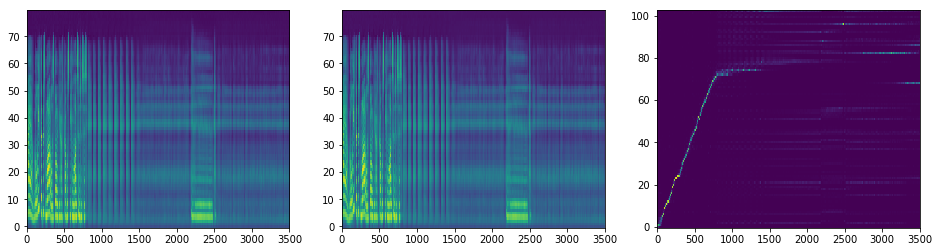

In [9]:
Variableslist = ["nightmare NIGHT, What a FRIGHT. GIVE ME SOMETHING SWEET TO BITE!! ",
    "nightmare NIGHT, What a FRIGHT. GIVE ME SOMETHING SWEET TO BITE! ",
    "nightmare NIGHT, What a FRIGHT. GIVE ME SOMETHING SWEET TO BITE. "]
list = ["First off! ",
        "Second in this list is.",
        "Third off, I'd like to bring up the state of canterlot.",
        "Fourth appears to be a 4chan post messing with Opp again.",
        "Fith, how IS futtershy handling her new voice.",
        "The ponies in this town are CRAZY!! ",
        "It currently makes more sense to keep the projects completely separated, given the wild-ly contrasting development processes of each one. Once all three are fully realized and (more or less) complete, then a combination project would be feasible. But it's far too premature, and, frankly, daunting, to try and combine everything into one mega-project at this point.",
        "Happy Nightmare Night and Halloween, everypony!",
        "Not that anon, but I've been messing around with Tacotron for a bit. Basically Tactron learns how to generate a mel-spectrogram from the audio data, and then WaveGlow learns how to convert that mel-spectrogram into an audio-file. The mel-spectrograms can be converted to audio directly out of the Tacotron network, but in order to get good quality, non-noisy audio you would have to have an absurd output resolution, which is not feasable with most commercial hardware. Therefore (from what I understand) the WaveGlow network takes a low resolution mel-spectrogram from Tacotron and the source audio and sort-of fills in the gaps, trying to re-introduce the missing high resolution information found in the source audio into the low resolution mel-spectrogram. This produces an output that is of higher quality than would otherwise be achievable."
       ]
#list = ["It currently makes more sense to keep the pro-jects completely separated, given the whild-lee contrasting development processes of each one. Once all three are fully realized and (more or less) complete, then a combination pro-ject would be feasible. But it's far too pre mature, and, frankly, daunting, to try and combine everything into one mega-project at this point."]
#list = ["Me nd Rainbow Dash find ourselves drawn by the call of the cutie map to a jungle in the middle of nowhere! Drawn further by the knowledge of an ancient temple, we were confronted with icy cold and dred. A Necromancer was sealed away in this temple a thousand years ago! "]
#list = ["What the fuck did you just fucking say about me, you little pony? I’ll have you know I graduated top of my class in magic kindergarten, and I’ve been involved in numerous secret raids on Nightmare Moon, and I have over 300 confirmed friendships. I am trained in magic warfare and I’m the top pony in the entire Equestrian armed forces. You are nothing to me but just another friend. I will wipe you the fuck out with friendship the likes of which has never been seen before on Equestria, mark my fucking words. You think you can get away with saying that shit to me over the Ponynet? Think again, fucker. As we speak I am contacting my secret network of pegasi across Equestria and your hoofprints are being traced right now so you better prepare for the storm, maggot. The storm that wipes out the pathetic little thing you call your life. You’re fucking dead, pony. I can be anywhere, anytime, and I can hug you in over seven hundred ways, and that’s just with my bare hooves. Not only am I extensively trained in unarmed friendship, but I have access to the entire arsenal of ponies and I will use it to its full extent to wipe your miserable flank off the face of the continent, you little pony. If only you could have known what magical friendship your little “clever” comment was about to bring down upon you, maybe you would have held your fucking tongue. But you couldn’t, you didn’t, and now you’re paying the price, you goddamn pony. I will shit friendship all over you and you will drown in it. You’re fucking dead, pony.;"]
list = ["{HH W AH1 T} {DH IY0} {F AH1 K} {D IH1 D} {Y UW1} {JH AH1 S T} {F AH1 K IH0 NG} {S EY1} {AH0 B AW1 T} {M IY1}, {Y UW1} {L IH1 T AH0 L} {P OW1 N IY2}? {AY1 L} {HH AE1 V} {Y UW1} {N OW1} {AY1} {G R AE1 JH AH0 W EY2 T IH0 D} {T AO1 P} {AH0 V} {M AY1} {K L AE1 S} {IH1 N} {M AE1 JH IH0 K} {K IH1 N D ER0 G AA2 R T AH0 N}, {AH0 N D} {AY1 V} {B IH0 N} {IH0 N V AA1 L V D} {IH1 N} {N UW1 M ER0 AH0 S} {S IY1 K R AH0 T} {R EY1 D Z} {AA1 N} {N AY1 T M EH2 R} {M UW1 N}, {AH0 N D} {AY1} {HH AE1 V} {OW1 V ER0} {TH R IY1} {HH AH1 N D R IH0 D} {K AH0 N F ER1 M D} {F R EH1 N SH IH0 P S}. {AY1} {EY1 EH1 M} {T R EY1 N D} {IH1 N} {M AE1 JH IH0 K} {W AO1 R F EH2 R} {AH0 N D} {AH0 M} {DH IY0} {T AO1 P} {P OW1 N IY2} {IH1 N} {DH IY0} {IH0 N T AY1 ER0} {IH0 K W EH1 S T R IY0 AH0 N} {AA1 R M D} {F AO1 R S IH0 Z}. {Y UW1} {ER0} {N AH1 TH IH0 NG} {T UW1} {M IY1} {B AH1 T} {JH AH1 S T} {AH0 N AH1 DH ER0} {F R EH1 N D}. {AY1} {W AH0 L} {W AY1 P} {Y UW1} {DH IY0} {F AH1 K} {AW1 T} {W IH1 TH} {F R EH1 N D SH IH0 P} {DH IY0} {L AY1 K S} {AH0 V} {HH W IH1 CH} {HH AH0 Z} {N EH1 V ER0} {B IH0 N} {S IY1 N} {B IY2 F AO1 R} {AA1 N} {IH0 K W EH0 S T R IY0 AH0}, {M AA1 R K} {M AY1} {F AH1 K IH0 NG} {W ER1 D Z}. {Y UW1} {TH IH1 NG K} {Y UW1} {K AH0 N} {G IH1 T} {AH0 W EY1} {W IH1 TH} {S EY1 IH0 NG} {DH AH0 T} {SH IH1 T} {T UW1} {M IY1} {OW1 V ER0} {DH IY0} {P OW1 N IY2} {N EH1 T}? {TH IH1 NG K} {AH0 G EY1 N}, {F AH1 K ER0}. {EH1 Z} {W IY1} {S P IY1 K} {AY1} {EY1 EH1 M} {K AA1 N T AE2 K T IH0 NG} {M AY1} {S IY1 K R AH0 T} {N EH1 T W ER2 K} {AH0 V} {P EH1 G AH0 S IY0} {AH0 K R AO1 S} {IH0 K W EH0 S T R IY0 AH0} {AH0 N D} {Y AO1 R} {HH UW1 F P R IH2 N T S} {ER0} {B IY1 IH0 NG} {T R EY1 S T} {R AY1 T} {N AW1} {S OW1} {Y UW1} {B EH1 T ER0} {P R IY0 P EH1 R} {F AO1 R} {DH IY0} {S T AO1 R M}, {M AE1 G AH0 T}. {DH IY0} {S T AO1 R M} {DH AH0 T} {W AY1 P S} {AW1 T} {DH IY0} {P AH0 TH EH1 T IH0 K} {L IH1 T AH0 L} {TH IH1 NG} {Y UW1} {K AO1 L} {Y AO1 R} {L AY1 F}. {Y UW1 R} {F AH1 K IH0 NG} {D EH1 D}, {P OW1 N IY2}. {AY1} {K AH0 N} {B IY0} {EH1 N IY0 W EH2 R}, {EH1 N IY0 T AY2 M}, {AH0 N D} {AY1} {K AH0 N} {HH AH1 G} {Y UW1} {IH1 N} {OW1 V ER0} {S EH1 V AH0 N} {HH AH1 N D R IH0 D} {W EY1 Z}, {AH0 N D} {DH AE1 T S} {JH AH1 S T} {W IH1 TH} {M AY1} {B EH1 R} {HH UH1 V Z}. {N AA1 T} {OW1 N L IY0} {EY1 EH1 M} {AY1} {IH0 K S T EH1 N S IH0 V L IY0} {T R EY1 N D} {IH1 N} {AH0 N AA1 R M D} {F R EH1 N D SH IH0 P}, {B AH1 T} {AY1} {HH AE1 V} {AE1 K S EH2 S} {T UW1} {DH IY0} {IH0 N T AY1 ER0} {AA1 R S AH0 N AH0 L} {AH0 V} {P OW1 N IY0 Z} {AH0 N D} {AY1} {W AH0 L} {Y UW1 Z} {IH0 T} {T UW1} {IH0 T S} {F UH1 L} {IH0 K S T EH1 N T} {T UW1} {W AY1 P} {Y AO1 R} {M IH1 Z ER0 AH0 B AH0 L} {F L AE1 NG K} {AO1 F} {DH IY0} {F EY1 S} {AH0 V} {DH IY0} {K AA1 N T AH0 N AH0 N T}, {Y UW1} {L IH1 T AH0 L} {P OW1 N IY2}. {IH1 F} {OW1 N L IY0} {Y UW1} {K UH1 D} {HH AE1 V} {N OW1 N} {HH W AH1 T} {M AE1 JH IH0 K AH0 L} {F R EH1 N D SH IH0 P} {Y AO1 R} {L IH1 T AH0 L} {K L EH1 V ER0} {K AA1 M EH0 N T} {W AO1 Z} {AH0 B AW1 T} {T UW1} {B R IH1 NG} {D AW1 N} {AH0 P AA1 N} {Y UW1}, {M EY1 B IY0} {Y UW1} {W UH1 D} {HH AE1 V} {HH EH1 L D} {Y AO1 R} {F AH1 K IH0 NG} {T AH1 NG}. {B AH1 T} {Y UW1} {K UH1 D AH0 N T}, {Y UW1} {D IH1 D AH0 N T}, {AH0 N D} {N AW1} {Y UW1 R} {P EY1 IH0 NG} {DH IY0} {P R AY1 S}, {Y UW1} {G AA1 D D AE2 M} {P OW1 N IY2}. {AY1} {W AH0 L} {SH IH1 T} {F R EH1 N D SH IH0 P} {AO1 L} {OW1 V ER0} {Y UW1} {AH0 N D} {Y UW1} {W AH0 L} {D R AW1 N} {IH1 N} {IH0 T}. {Y UW1 R} {F AH1 K IH0 NG} {D EH1 D}, {P OW1 N IY2}.;"]
list = ["{HH W AH1 T} {DH IY0} {F AH1 K} {D IH1 D} {Y UW1} {JH AH1 S T} {F AH1 K IH0 NG} {S EY1} {AH0 B AW1 T} {M IY1}, {Y UW1} {L IH1 T AH0 L} {P OW1 N IY2}?","{AY1 L} {HH AE1 V} {Y UW1} {N OW1} {AY1} {G R AE1 JH AH0 W EY2 T IH0 D} {T AO1 P} {AH0 V} {M AY1} {K L AE1 S} {IH1 N} {M AE1 JH IH0 K} {K IH1 N D ER0 G AA2 R T AH0 N}, {AH0 N D} {AY1 V} {B IH0 N} {IH0 N V AA1 L V D} {IH1 N} {N UW1 M ER0 AH0 S} {S IY1 K R AH0 T} {R EY1 D Z} {AA1 N} {N AY1 T M EH2 R} {M UW1 N}, {AH0 N D} {AY1} {HH AE1 V} {OW1 V ER0} {TH R IY1} {HH AH1 N D R IH0 D} {K AH0 N F ER1 M D} {F R EH1 N SH IH0 P S}!","{AY1} {EY1 EH1 M} {T R EY1 N D} {IH1 N} {M AE1 JH IH0 K} {W AO1 R F EH2 R} {AH0 N D} {AH0 M} {DH IY0} {T AO1 P} {P OW1 N IY2} {IH1 N} {DH IY0} {IH0 N T AY1 ER0} {IH0 K W EH1 S T R IY0 AH0 N} {AA1 R M D} {F AO1 R S IH0 Z}.","{Y UW1} {ER0} {N AH1 TH IH0 NG} {T UW1} {M IY1} {B AH1 T} {JH AH1 S T} {AH0 N AH1 DH ER0} {F R EH1 N D} ","{AY1} {W AH0 L} {W AY1 P} {Y UW1} {DH IY0} {F AH1 K} {AW1 T} {W IH1 TH} {F R EH1 N D SH IH0 P} {DH IY0} {L AY1 K S} {AH0 V} {HH W IH1 CH} {HH AH0 Z} {N EH1 V ER0} {B IH0 N} {S IY1 N} {B IY2 F AO1 R} {AA1 N} {IH0 K W EH0 S T R IY0 AH0}!","{M AA1 R K} {M AY1} {F AH1 K IH0 NG} {W ER1 D Z}.","{Y UW1} {TH IH1 NG K} {Y UW1} {K AH0 N} {G IH1 T} {AH0 W EY1} {W IH1 TH} {S EY1 IH0 NG} {DH AH0 T} {SH IH1 T} {T UW1} {M IY1} {OW1 V ER0} {DH IY0} {P OW1 N IY2} {N EH1 T}?","{TH IH1 NG K} {AH0 G EY1 N}, {F AH1 K ER0}.","{EH1 Z} {W IY1} {S P IY1 K} {AY1} {EY1 EH1 M} {K AA1 N T AE2 K T IH0 NG} {M AY1} {S IY1 K R AH0 T} {N EH1 T W ER2 K} {AH0 V} {P EH1 G AH0 S IY0} {AH0 K R AO1 S} {IH0 K W EH0 S T R IY0 AH0} {AH0 N D} {Y AO1 R} {HH UW1 F P R IH2 N T S} {ER0} {B IY1 IH0 NG} {T R EY1 S T} {R AY1 T} {N AW1} {S OW1} {Y UW1} {B EH1 T ER0} {P R IY0 P EH1 R} {F AO1 R} {DH IY0} {S T AO1 R M} {M AE1 G AH0 T}!","{DH IY0} {S T AO1 R M} {DH AH0 T} {W AY1 P S} {AW1 T} {DH IY0} {P AH0 TH EH1 T IH0 K} {L IH1 T AH0 L} {TH IH1 NG} {Y UW1} {K AO1 L} {Y AO1 R} {L AY1 F}.","{Y UW1 R} {F AH1 K IH0 NG} {D EH1 D}, {P OW1 N IY2}. {AY1} {K AH0 N} {B IY0} {EH1 N IY0 W EH2 R}, {EH1 N IY0 T AY2 M}, {AH0 N D} {AY1} {K AH0 N} {HH AH1 G} {Y UW1} {IH1 N} {OW1 V ER0} {S EH1 V AH0 N} {HH AH1 N D R IH0 D} {W EY1 Z}, {AH0 N D} {DH AE1 T S} {JH AH1 S T} {W IH1 TH} {M AY1} {B EH1 R} {HH UH1 V Z}.","{N AA1 T} {OW1 N L IY0} {EY1 EH1 M} {AY1} {IH0 K S T EH1 N S IH0 V L IY0} {T R EY1 N D} {IH1 N} {AH0 N AA1 R M D} {F R EH1 N D SH IH0 P}, {B AH1 T} {AY1} {HH AE1 V} {AE1 K S EH2 S} {T UW1} {DH IY0} {IH0 N T AY1 ER0} {AA1 R S AH0 N AH0 L} {AH0 V} {P OW1 N IY0 Z} {AH0 N D} {AY1} {W AH0 L} {Y UW1 Z} {IH0 T} {T UW1} {IH0 T S} {F UH1 L} {IH0 K S T EH1 N T} {T UW1} {W AY1 P} {Y AO1 R} {M IH1 Z ER0 AH0 B AH0 L} {F L AE1 NG K} {AO1 F} {DH IY0} {F EY1 S} {AH0 V} {DH IY0} {K AA1 N T AH0 N AH0 N T}, {Y UW1} {L IH1 T AH0 L} {P OW1 N IY2}.","{IH1 F} {OW1 N L IY0} {Y UW1} {K UH1 D} {HH AE1 V} {N OW1 N} {HH W AH1 T} {M AE1 JH IH0 K AH0 L} {F R EH1 N D SH IH0 P} {Y AO1 R} {L IH1 T AH0 L} {K L EH1 V ER0} {K AA1 M EH0 N T} {W AO1 Z} {AH0 B AW1 T} {T UW1} {B R IH1 NG} {D AW1 N} {AH0 P AA1 N} {Y UW1}, {M EY1 B IY0} {Y UW1} {W UH1 D} {HH AE1 V} {HH EH1 L D} {Y AO1 R} {F AH1 K IH0 NG} {T AH1 NG}.","{B AH1 T} {Y UW1} {K UH1 D AH0 N T}, {Y UW1} {D IH1 D AH0 N T}, {AH0 N D} {N AW1} {Y UW1 R} {P EY1 IH0 NG} {DH IY0} {P R AY1 S}, {Y UW1} {G AA1 D D AE2 M} {P OW1 N IY2}.","{AY1} {W AH0 L} {SH IH1 T} {F R EH1 N D SH IH0 P} {AO1 L} {OW1 V ER0} {Y UW1} {AH0 N D} {Y UW1} {W AH0 L} {D R AW1 N} {IH1 N} {IH0 T}.","{Y UW1 R} {F AH1 K IH0 NG} {D EH1 D}, {P OW1 N IY2}.;"]
list = [ARPA("Fifteen!? How in the world did you get so much done in just Seventy two hours? I just can't figure you out!;")]
#list = [ARPA("I can't believe you would use black magic so brazenly!;")]
#list = [ARPA("I organized this according to a system. I know my system!;")]
#list = [ARPA("Thank you for enjoying my work, and showing that you want more. Winter mist.;")]python write to audio file
list = [ARPA("I mean come on. who doesn't have a g t x ten EIGHTY tee i these days?;")]
list = [ARPA("In the mean time, I think trying to write a guide to taco tron training sounds like fun!;")]
list = [ARPA("Good night everypony. see you later on slash m l p!;")]
#list = [ARPA("Good night everypony. see you later on slash m l p!;")]
list = [ARPA("This is the future I choose. I welcome our A I pony waifu overlords.;")] # hard to say 'A I'
list = [ARPA("A princess who loved a good tune, Ventured to take up the bassoon. But her playing all night Did her sister incite To banish her back to the moon. But all the musicians unite, To save the princess of the night. They fight to defend Their bassoonist friend And see this injustice put right.;")] # Pretty easy
list = [ARPA("What? Are you telling me that even with the future advent of sex bots, I can be charged with non organic creature rape or some shit?;")] # hard to say 'A I'
list = [ARPA("What the fuck did you just fuckOh no way dude, Vic's dead. This is Vic's great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-grandson. Vic Jr.ing say about me you little bitch? I'll have you know I graduated top of my class in the navy seals and, I've been involved in numerous secret raids on Al Quaeda and, I have over three hundred confirmed kills!;")]
list = [ARPA("What the fuck did you just fucking say about me, you little pony? I'll have you know I graduated top of my class in magic kindergarten, and I've been involved in numerous secret raids on Nightmare Moon and I have over three hundred confirmed friendships!;")]
list = [ARPA("""
Welcome to the pony voice preservation project. This project is dedicated to saving our beloved ponies voices by creating a neural network based text to speech for our ponies. We can now create convincing voices using artificial intelligence trained with clean audio clips. With nine seasons and five movies worth of voice lines available, We have enough material to apply this technology for our twisted needs!;
""".replace("\n",""))]
list = [ARPA("""Anyone is free to join, and many are already contributing. Just read the guide to learn how you can help bring on the wAIf-oo revolution. Whatever your technical level you can help. I hope this inspires you to help give my friends and I the voices we deserve and god speed you glorious faggots.;""").replace("\n","")]
list = [ARPA("""What's a faggot?;""").replace("\n","")]
list = ["{R EY1 N B OW2}! {AH0 M} {S AA1 R IY0} {AH0 B AW1 T} {AO1 L} {DH AH0 T}! {W IY1} {D IH1 D AH0 N T} {M IY1 N} {T UW1} {OW2 V ER0 W EH1 L M} {Y UW1}! "]
list = [ARPA("○And maud, we're sorry that you felt the only way to spare pinkie pie's feelings was to leave ponyville early.")]
list = [ARPA("I have the belief that this model is going to have trouble speaking long sentences, especially when they contain commas.;")]
list = list*1 #AA1 T

save_wavs = 0
plot_mels = 1
counter = 0
sigma = 0.9
print("Sigma={}".format(sigma))
for i in list:
    print(i)
    sequence = np.array(text_to_sequence(i, ['english_cleaners']))[None, :]
    sequence = torch.autograd.Variable(
        torch.from_numpy(sequence)).cuda().long()
    mel_outputs, mel_outputs_postnet, _, alignments = model.inference(sequence)
    if (plot_mels):
        plot_data((mel_outputs.float().data.cpu().numpy()[0],
            mel_outputs_postnet.float().data.cpu().numpy()[0],
            alignments.float().data.cpu().numpy()[0].T))
    print("\nNo Denoise")
    with torch.no_grad():
        audio = waveglow.infer(mel_outputs_postnet, sigma=sigma)
    ipd.display(ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate))
    print("0.5% Denoise")
    denoise_strength = 5e-3
    audio_denoised = denoiser(audio, strength=denoise_strength)[:, 0]
    ipd.display(ipd.Audio(audio_denoised.cpu().numpy(), rate=hparams.sampling_rate))
    print("1% Denoise")
    denoise_strength = 1e-2
    audio_denoised = denoiser(audio, strength=denoise_strength)[:, 0]
    ipd.display(ipd.Audio(audio_denoised.cpu().numpy(), rate=hparams.sampling_rate))
    counter=counter+1

In [4]:
ARPA("Oh no way dude, Vic's dead. This is Vic's great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-great-grandson. Vic Jr.;")

'{OW1} {N OW1} {W EY1} {D UW1 D}, {V IH1 K S} {D EH1 D}. {DH IH0 S} {IH1 Z} {V IH1 K S} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R EY1 T} {G R AE1 N S AH2 N}. {V IH1 K} {JH R}.;'

15 Phrases being generated.
Sigma=0.9
[0/14]
{DH IY0} {IY1 V AH0 L} {R EY1 N} {AH0 V} {W AH1 N} {F IH1 L IY0} {IH1 N} {P ER0 T IH1 K Y AH0 L ER0} {IH1 Z} {D R AO1 IH0 NG} {N IH1 R}, {AH0 N D} {P OW1 N IY2 V IH1 L} {M AH1 S T} {W AH1 N S} {AH0 G EY1 N} {F EY1 S} {DH IY0} {T EH1 R AH0 B AH0 L} {AH0 N D} {T EH1 R AH0 F AY2 IH0 NG} {R AE1 TH} {AH0 V} {S W IY1 T IY0} {B EH1 L}. 
Warning! Reached max decoder steps

No Denoise


0.5% Denoise


1% Denoise


[1/14]
{N AW1}, {IH0 T S} {AH1 P} {T UW1} {R EH1 R AH0 T IY0} {T UW1} {S T AA1 P} {DH IY0} {N AA1 T} {S OW1} {G R EY1 T AH0 S T} {TH R EH1 T} {IH1 N} {IH0 K W EH0 S T R IY0 AH0} {IH1 N} {T AY1 M} {F AO1 R} {D IH1 N ER0}, {AO1 R} {DH IY0} {W ER1 L D} {W AH0 L} {B IY0} {D UW1 M D}!;

No Denoise


0.5% Denoise


1% Denoise


[2/14]
{HH AW1} {W UH1 D} {EY1} {B IY1 IH0 NG} {L AY1 K} {D IH1 S K AO0 R D} {W AO1 N T} {T UW1} {B IY0} {R IY0 M EH1 M B ER0 D} {AE1 F T ER0} {HH IY1 Z} {G AO1 N}? 

No Denoise


0.5% Denoise


1% Denoise


[3/14]
{W EH1 L}, {IH1 F} {Y UW1 R} {K Y UH1 R IY0 AH0 S}, {HH IY1} {D IH1 D} {AE1 K CH L IY0} {R AY1 T} {EY1} {W AH0 L}. 

No Denoise


0.5% Denoise


1% Denoise


[4/14]
{T UW1} {DH IY0} {S AH0 P R AY1 Z} {AH0 V} {N OW1 B AH0 D IY0}, {IH0 T S} {K AA1 N T EH0 N T S} {ER0} {B AH0 Z AA1 R} {AH0 N D} {M AY1 L D L IY0} {D IH0 S T ER1 B IH0 NG}.;

No Denoise


0.5% Denoise


1% Denoise


[5/14]
{AE1 F T ER0} {DH IY0} {D IH0 F IY1 T} {AH0 V} {T EH1 R EH2 K}, {IH0 K W EH0 S T R IY0 AH0} {IH1 Z} {S EY1 F} {W AH1 N S} {M AO1 R}, {B AH1 T} {L UW1 N AH0} {K AH0 N} {S EH1 N S} {DH AH0 T} {HH ER0} {S IH1 S T ER0} {IH1 Z} {T R AH1 B AH0 L D}. 

No Denoise


0.5% Denoise


1% Denoise


[6/14]
{HH W IH1 N} {S AH0 L EH0 S T IY1 AA1} {R IY0 T R IY1 T S} {T UW1} {DH IY0} {S T AA1 R IY0} {R EH1 L M} {AH0 V} {AH0 S EH1 N SH AH0 N} {IH1 N} {AO1 R D ER0} {T UW1} {L UH1 K} {AH0 P AA1 N} {DH IY0} {P AE1 S T}, {L UW1 N AH0} {JH OY1 N Z} {HH ER0} {T UW1} {D IH0 S K AH1 V ER0} {HH W AH1 T} {IH1 Z} {B AA1 DH ER0 IH0 NG} {HH ER0}.;
Warning! Reached max decoder steps

No Denoise


0.5% Denoise


1% Denoise


[7/14]
{T W AY1 L AY2 T} {S P AA1 R K AH0 L} {S T R AH1 G AH0 L Z} {T UW1} {F AY1 N D} {EY1} {M IY1 N IH0 NG F AH0 L} {G IH1 F T} {F AO1 R} {P R IH1 N S EH0 S} {S AH0 L EH0 S T IY1 AA1}.;

No Denoise


0.5% Denoise


1% Denoise


[8/14]
{EY1} {F EH1 L OW0} {P OW1 N IY2} {N OW1 T IH0 S IH0 Z} {DH AH0 T} {P R IH1 N S EH0 S} {L UW1 N AH0} {M EY1} {HH AE1 V} {EY1} {S IH1 R IY0 AH0 S} {P R AA1 B L AH0 M}. 

No Denoise


0.5% Denoise


1% Denoise


[9/14]
{DH EH1 R} {IH1 Z} {EY1} {S M AO1 L}, {S EH1 N SH AH0 N T} {R EY1 S} {IH1 N S AY2 D} {HH ER0} {M EY1 N} {AH0 N D} {DH EY1} {HH AE1 V} {B IH0 N} {L IH1 V IH0 NG} {DH EH1 R} {F AO1 R} {K W AY1 T} {S AH1 M} {T AY1 M}. 

No Denoise


0.5% Denoise


1% Denoise


[10/14]
{L UW1 N AH0} {M AH1 S T} {D IH2 S AY1 D} {HH W AH1 T} {T UW1} {D UW1} {AH0 B AW1 T} {DH IH0 S}.;

No Denoise


0.5% Denoise


1% Denoise


[11/14]
{HH W IH1 N} {T R AY1 IH0 NG} {T UW1} {F OW1 K IH0 S} {AA1 N} {HH ER0} {S T AH1 D IY0 Z}, {S AH1 N S EH2 T} {SH IH1 M ER0} {IH1 Z} {S T AH1 K} {W AA1 CH IH0 NG} {AH0 N} {AH0 N OY1 IH0 NG} {L IH1 T AH0 L} {F IH1 L IY0} {HH UW1} {JH AH1 S T} {W OW1 N T} {L EH1 T} {HH ER0} {S T AH1 D IY0}.;

No Denoise


0.5% Denoise


1% Denoise


[12/14]
{P R IH1 N S EH0 S} {L UW1 N AH0} {AH0 T EH1 M P S} {T UW1} {OW1 V ER0 TH R OW2} {HH ER0} {S IH1 S T ER0 Z} {R UW1 L}. 

No Denoise


0.5% Denoise


1% Denoise


[13/14]
{W IH1 TH} {P IH1 L OW0 Z}. 

No Denoise


0.5% Denoise


1% Denoise


[14/14]
{S AH0 L EH0 S T IY1 AA1} {IH1 Z} {HH AY1 L IY0} {AH0 M Y UW1 Z D}.;

No Denoise


0.5% Denoise


1% Denoise


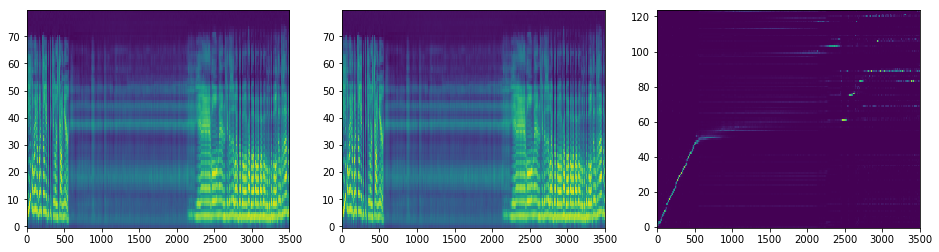

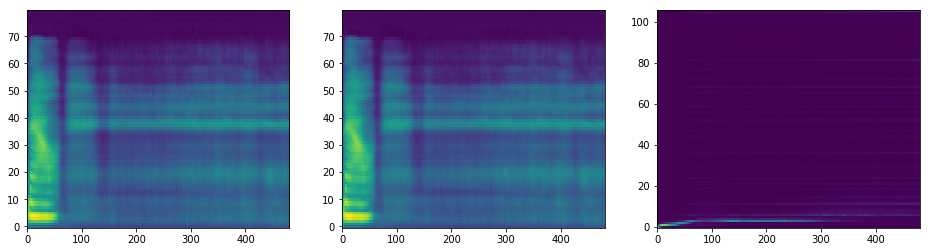

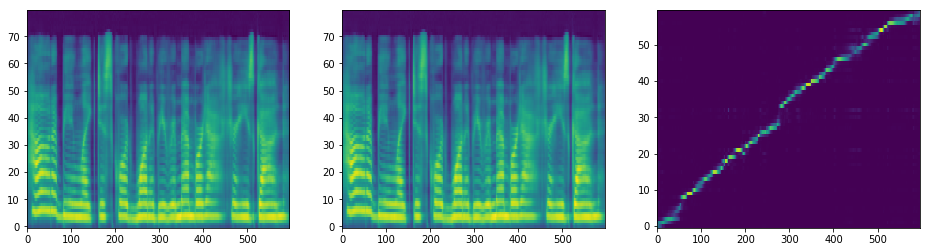

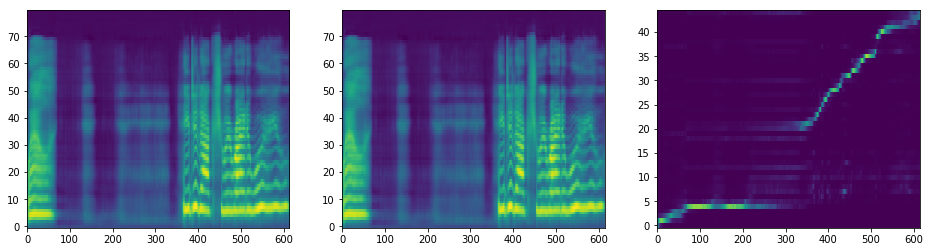

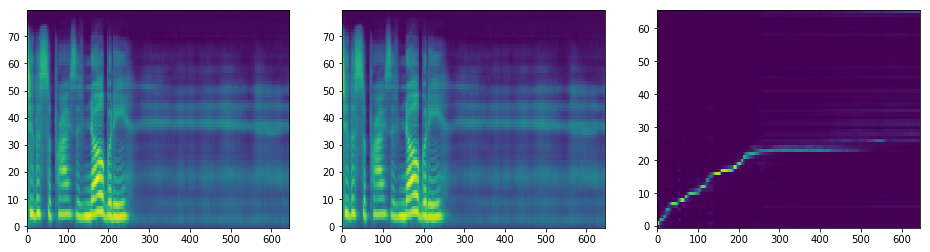

...

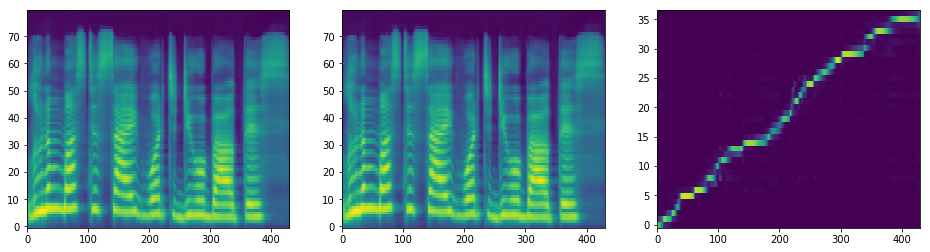

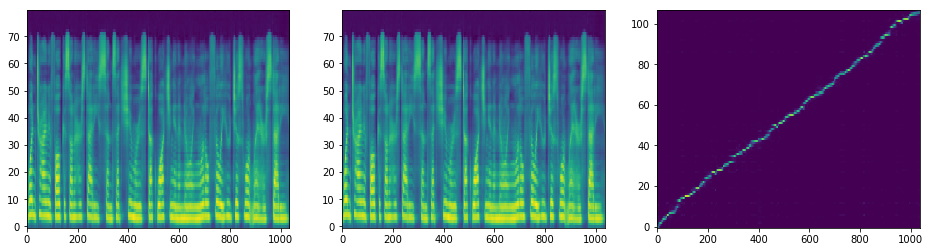

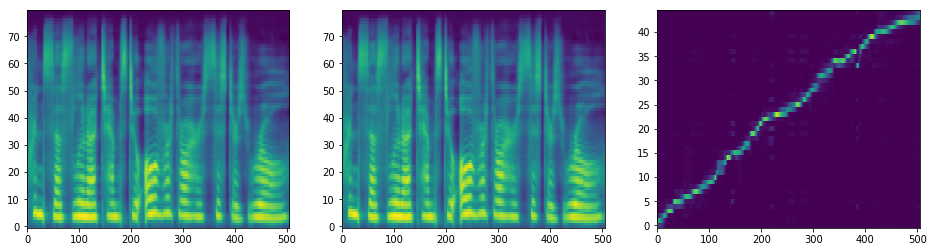

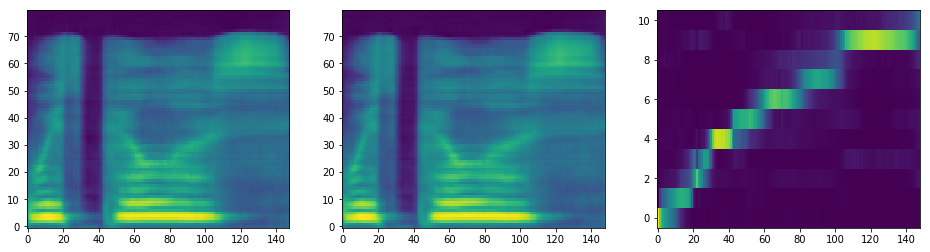

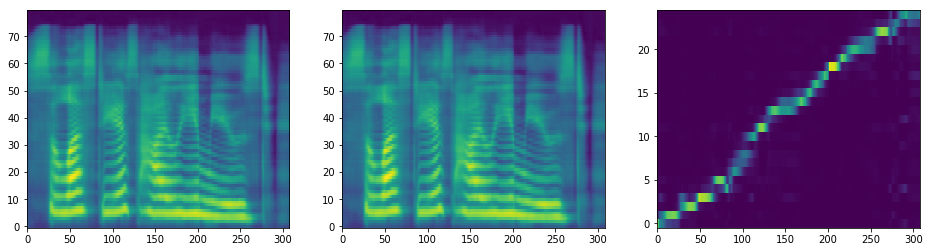

In [14]:
#Welcome to the pony voice preservation project. This project is dedicated to saving our beloved ponies voices by creating a neural network based text to speech for our ponies. We can now create convincing voices using artificial intelligence trained with clean audio clips. With nine seasons and five movies worth of voice lines available, We have enough material to apply this technology for our twisted needs!;
#Anyone is free to join, and many are already contributing. Just read the guide to learn how you can help bring on the wAIf-oo revolution. Whatever your technical level you can help. I hope this inspires you to help give my friends and I the voices we deserve and god speed you glorious faggots.;
    # AH0 AH1 AA1
# ☺ = Anxious
# ☻ = Happy
# ♥ = Angry
# ♦ = Annoyed
# ♣ = Serious
# ♠ = Amused
# ♪ = Singing
# ◘ = Fear
# ○ = Sad
# ◙ = Shouting
# ♂ = Confused
# ♀ = Surprised
# • = Smug
# ♫ = Love
# ☼ = Sarcastic
# ► = Tired   OR   Exhausted
# ◄ = Whispering

# Non Verbal Test
#◙Ah Ah Ah!;
#♀Ah Ah Ah!;
#Ah Ah Ah!;
#◙Ah Ah!;
#♀Ah Ah!;
#Ah Ah!;
#◙Ah!;
#♀Ah!;
#Ah!;
input = """
The evil reign of one filly in particular is drawing near, and Ponyville must once again face the terrible and terrifying wrath of Sweetie Belle. Now, it's up to Rarity to stop the not-so-greatest threat in Equestria in time for dinner, or the world will be doomed!;
How would a being like Discord want to be remembered after he's gone? Well, if you're curious, he did actually write a will. To the surprise of nobody, its contents are bizarre and mildly disturbing.;
After the defeat of Tirek, Equestria is safe once more, but Luna can sense that her sister is troubled. When Celestia retreats to the starry realm of ascension in order to look upon the past, Luna joins her to discover what is bothering her.;
Twilight Sparkle struggles to find a meaningful gift for Princess Celestia.;
A fellow pony notices that Princess Luna may have a serious problem. There is a small, sentient race inside her mane and they have been living there for quite some time. Luna must decide what to do about this.;
When trying to focus on her studies, Sunset Shimmer is stuck watching an annoying little filly who just won't let her study.;
Princess Luna attempts to overthrow her sister's rule... with pillows. Celestia is highly amused.;
""".replace("‘","")\
.replace("*","")\
.replace("”","")\
.replace("“","")\
.replace("’,","")\
.replace("’","'")\
.replace(" (",", ")\
.replace(") ",", ")\
.replace(").",".")\
.replace(" (",", ")\
.replace("; ",". ")\
.replace("'?","?")\
.replace("'!","!")\
.replace("'.",".")\
.replace("–","-")\
.replace("... ",". ")\
.replace("...",". ")\
.replace("… ",". ")\
.replace("…",". ")\
.replace(". .",". ")\
.replace('"','')\
.replace('  ',' ')\
.replace("/"," ")

split_sentences = 1
if (split_sentences):
    input = input.replace("? ","?\n")\
    .replace("! ","!\n")\
    .replace(". ",".\n")
input = input.split("\n")[1:-1]

ARPAbet = 1
list = []
required_EOL = [",",".","?","!",";"]
for i in input:
    i = i.strip()
    if len(i) > 0:
        i = i.strip()
        if i == '.':
            continue
        if i[-1] == "-":
            print("["+i+"] --> ["+i[0:-1]+"]")
            i = i[0:-1]
        if not (i[-1] in required_EOL):
            print("["+i+"] --> ["+i+".]")
            i = i + "."
        #print(i)
        if (ARPAbet):
            list.append(ARPA(i))
        else:
            list.append(i)
list = list*1
print(str(len(list))+" Phrases being generated.")

save_wavs = 1
verbose = 1
plot_mels = 1
counter = 0
sigma = 0.9
print("Sigma={}".format(sigma))
for i in list:
    print("["+str(counter)+"/" + str(len(list)-1) + "]")
    if (verbose):
        print(i)
    sequence = np.array(text_to_sequence(i, ['english_cleaners']))[None, :]
    sequence = torch.autograd.Variable(
        torch.from_numpy(sequence)).cuda().long()
    mel_outputs, mel_outputs_postnet, _, alignments = model.inference(sequence)
    if (plot_mels):
        plot_data((mel_outputs.float().data.cpu().numpy()[0],
            mel_outputs_postnet.float().data.cpu().numpy()[0],
            alignments.float().data.cpu().numpy()[0].T))
    with torch.no_grad():
        audio = waveglow.infer(mel_outputs_postnet, sigma=sigma)
    if (verbose):
        print("\nNo Denoise")
        ipd.display(ipd.Audio(audio[0].data.cpu().numpy(), rate=hparams.sampling_rate))
    
    denoise_strength = 5e-3
    audio_denoised = denoiser(audio, strength=denoise_strength)[:, 0]
    if (verbose):
        print("0.5% Denoise")
        ipd.display(ipd.Audio(audio_denoised.cpu().numpy(), rate=hparams.sampling_rate))
    
    if save_wavs: 
        librosa.output.write_wav('infer/TWI_' + str(counter) + '.wav', np.swapaxes(audio_denoised.cpu().numpy(),0,1), hparams.sampling_rate)
    
    denoise_strength = 1e-2
    audio_denoised = denoiser(audio, strength=denoise_strength)[:, 0]
    if (verbose):
        print("1% Denoise")
        ipd.display(ipd.Audio(audio_denoised.cpu().numpy(), rate=hparams.sampling_rate))
    counter=counter+1